<h1><center>CSCI 6515 - Machine Learning for Big Data (Fall 2023)</h1></center>
<h1><center>Assignment 2</h1></center>

<b>Mudra Verma</b>  
<b>Banner ID: B00932103</b>  


### 1. Task 1<a id='top'></a>

The data was obtained through Kaggle Heart Disease Dataset [1].

#### i) Subtask 1.a

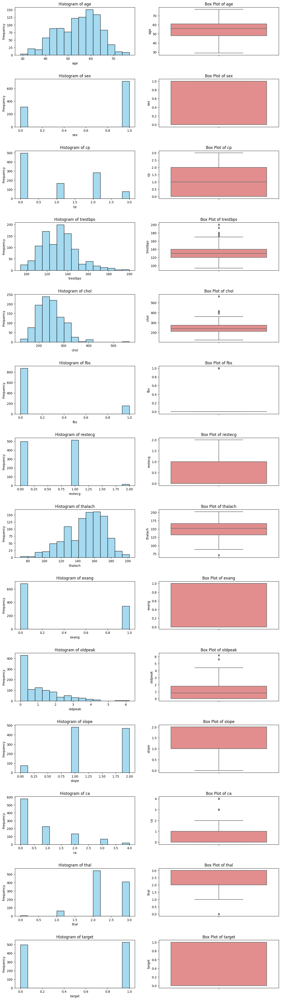

In [1]:
### Preprocessing the Heart Disease Dataset ###

## Load and Visualize the dataset ##

import matplotlib.pyplot as plt
import seaborn as sns

import pandas as pd
data = pd.read_csv('heart.csv')

# Select all numerical attributes (assuming they are of numeric data type)
numerical_attributes = data.select_dtypes(include=['int64', 'float64'])

# Set up the subplots
num_attributes_count = len(numerical_attributes.columns)
fig, axes = plt.subplots(num_attributes_count, 2, figsize=(15, 4 * num_attributes_count))
fig.subplots_adjust(hspace=0.5)

for i, attribute in enumerate(numerical_attributes.columns):
    # Create histograms
    sns.histplot(data=data, x=attribute, bins=15, ax=axes[i, 0], color='skyblue', edgecolor='black')
    axes[i, 0].set_title(f'Histogram of {attribute}')
    axes[i, 0].set_xlabel(attribute)
    axes[i, 0].set_ylabel('Frequency')

    # Create box plots
    sns.boxplot(data=data, y=attribute, ax=axes[i, 1], color='lightcoral')
    axes[i, 1].set_title(f'Box Plot of {attribute}')
    axes[i, 1].set_ylabel(attribute)

# Show the plots
plt.show()

In [2]:
#### Replacing missing values with most frequent values [2]####

import pandas as pd
from sklearn.impute import SimpleImputer

data_o = pd.read_csv('heart.csv')

# Initialize a SimpleImputer with your chosen strategy (e.g., 'mean', 'median', 'most_frequent', or a constant value)
imputer = SimpleImputer(strategy='most_frequent')

# Fit the imputer to the entire dataset and transform it
data = imputer.fit_transform(data_o)

# Convert the result back to a DataFrame (optional but useful for further analysis)
data = pd.DataFrame(data, columns=data_o.columns)

Missing values were replaced with the most frequent values in the dataset for the following reasons:
1. Categorical Data: As the dataset contains categorical values using the mean or median may not be appropriate, as these statistics are meant for continuous numerical data.
2. Robustness to Outliers: Using the mean can be sensitive to outliers, as a single extreme value can significantly impact the mean. The median is more robust to outliers but still assumes a certain continuity in the data. The most frequent value, on the other hand, is robust to outliers and can be a better representation of the central tendency of categorical or discrete data.
3. Preserving Data Distribution: Replacing missing values with the most frequent value maintains the distribution of the existing data.

In [3]:
#### Handling outliers by performing transformations ####

import pandas as pd
import numpy as np
from scipy import stats

# Specify the columns and transformations
columns_to_transform = {
    'trestbps': 'log',
    'chol': 'log',
    'thalach': 'boxcox'
}

# Apply transformations
for column, transformation in columns_to_transform.items():
    if transformation == 'log':
        data[column] = np.log(data[column])
    if transformation == 'boxcox':
        if (data[column] > 0).all():
            data[column] = stats.boxcox(data[column])[0]
        else:
            print(f"Skipping '{column}' due to non-positive values.")
            
        
# Save the transformed data to a new CSV file
data.to_csv('log_data.csv', index=False)

# Check your transformed dataset
print(data.head())

    age  sex   cp  trestbps      chol  fbs  restecg       thalach  exang  \
0  52.0  1.0  0.0  4.828314  5.356586  0.0      1.0  31304.532739    0.0   
1  53.0  1.0  0.0  4.941642  5.313206  1.0      0.0  26281.503550    1.0   
2  70.0  1.0  0.0  4.976734  5.159055  0.0      1.0  16473.095376    1.0   
3  61.0  1.0  0.0  4.997212  5.313206  0.0      1.0  28540.977829    0.0   
4  62.0  0.0  0.0  4.927254  5.683580  1.0      1.0  11515.360455    0.0   

   oldpeak  slope   ca  thal  target  
0      1.0    2.0  2.0   3.0     0.0  
1      3.1    0.0  0.0   3.0     0.0  
2      2.6    0.0  0.0   3.0     0.0  
3      0.0    2.0  1.0   3.0     0.0  
4      1.9    1.0  3.0   2.0     0.0  


After observing the outliers in the dataset it was observed that features 'trestbps' and 'chol' are right-skewed or positive skewed. Which demonstrates that most values are clustered around the left tail of the distribution while the right tail of the distribution is longer. Hence log transformation was used here to handle outliers [3]. Log transformation is effective in reducing right-skewness in the distribution of a variable. In the context of this dataset, applying log transformation to attributes like 'trestbps' and 'chol' could help mitigate the impact of outliers or long tails in the distributions, making the data more symmetrical and aligning it better with the assumptions of some statistical models [3].

Wherease the feature thalach was slightly left-skewed or negavite skewed. Hence Box-Cox transformation was used to make data more closely follow a normal distribution or stabilizing variances. It can make the data more closely resemble a normal  distribution, which can be beneficial for various statistical methods that assume normality [4].

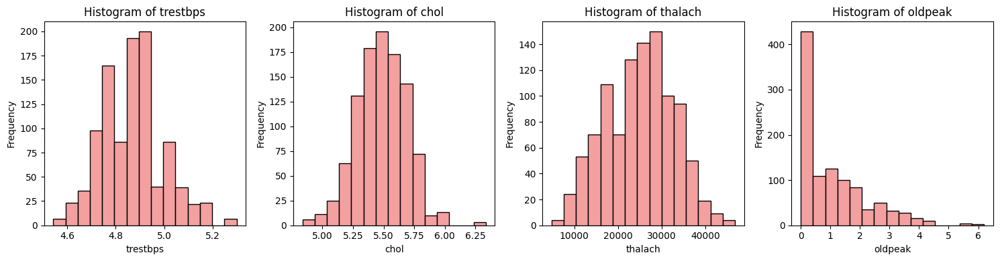

In [4]:
#### Visualizing data after transformations ####

import matplotlib.pyplot as plt
import seaborn as sns

transformed_data = pd.read_csv('log_data.csv')

# Specify the features to plot histograms for
features_to_plot = ['trestbps', 'chol', 'thalach','oldpeak']

# Set up subplots for histograms
num_features = len(features_to_plot)
fig, axes = plt.subplots(1, num_features, figsize=(15, 4))

# Plot histograms for each feature
for i, feature in enumerate(features_to_plot):
    sns.histplot(data=transformed_data, x=feature, bins=15, ax=axes[i], color='lightcoral', edgecolor='black')
    axes[i].set_title(f'Histogram of {feature}')
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Frequency')

# Show the plots
plt.tight_layout()
plt.show()


As per the above representation it can be seen that there still are outliers in features 'chol' and 'oldpeak'. An appropriate solution to this would be to remove these outliers as they may introduce inconsistency in the dataset. Some outliers are exceptionally extreme and may not be adequately handled by standard data transformations. Log transformation and Box-Cox transformation are effective for addressing moderate skewness, but they may not fully normalize the data when dealing with exceptionally large or small values. Removing such extreme outliers is a reasonable approach to prevent them from disproportionately affecting the analysis [5] [6].

In [5]:
#### Eliminating still persistent outliers ####

filtered_data = data[data['oldpeak'] <= 5]
filtered_data = filtered_data[filtered_data['chol'] <= 6.1]

# Save the combined filtered dataset as 'log_data.csv'
filtered_data.to_csv('log_data.csv', index=False)

In [6]:
#### Normalizing data after handling outliers [7]####

from sklearn.preprocessing import MinMaxScaler

import pandas as pd
data = pd.read_csv('log_data.csv')

# Select the features to be standardized (e.g., all columns except the target variable)
X = data.drop(columns=['target'])

# Create a StandardScaler
scaler = MinMaxScaler()

# Fit the scaler to the data and transform it
X_standardized = scaler.fit_transform(X)

# Replace the original features with the standardized ones
data.loc[:, X.columns] = X_standardized

# Now, 'data' contains the standardized features

data.to_csv('logn_data.csv', index=False)

After handling outliers the data is then normalized to ensure that the model is not dominated by the remaining inliers or by the scales of different features. It allows the model to better capture patterns and relationships within the data, leading to improved predictive performance. Data from different sources or different features may have varying units and scales. Normalization standardizes the data, making it comparable across features.Moreover, outliers can be considered noise in the data. Normalization reduces the impact of this noise on the analysis, improving the overall signal-to-noise ratio in the data.

#### i) Subtask 1.b

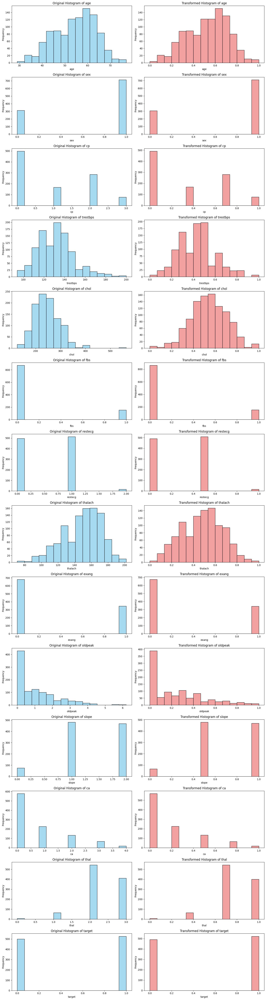

In [7]:
#### Visually analyzing data after processing and comparing with the original dataset ####

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

original_data = pd.read_csv('heart.csv')
transformed_data = pd.read_csv('logn_data.csv')

# Get the list of attributes in the dataset
attributes = original_data.columns

# Set up the subplots
num_attributes_count = len(attributes)
fig, axes = plt.subplots(num_attributes_count, 2, figsize=(15, 4 * num_attributes_count))
fig.subplots_adjust(wspace=0.5, hspace=0.5)

for i, attribute in enumerate(attributes):
    # Create histograms for the original data
    sns.histplot(data=original_data, x=attribute, bins=15, ax=axes[i, 0], color='skyblue', edgecolor='black')
    axes[i, 0].set_title(f'Original Histogram of {attribute}')
    axes[i, 0].set_xlabel(attribute)
    axes[i, 0].set_ylabel('Frequency')

    # Create histograms for the transformed data
    sns.histplot(data=transformed_data, x=attribute, bins=15, ax=axes[i, 1], color='lightcoral', edgecolor='black')
    axes[i, 1].set_title(f'Transformed Histogram of {attribute}')
    axes[i, 1].set_xlabel(attribute)
    axes[i, 1].set_ylabel('Frequency')

# Show the plots
plt.tight_layout()
plt.show()

#### i) Subtask 1.c

Justification for descriptive analysis is provided after each step.

### 2. Task 2

#### i) Subtask 2.a

In [8]:
#### Applying Naive Bayes Classifier to the data [8]####

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report, accuracy_score

data = pd.read_csv('logn_data.csv')

# Define features and the target variable
X = data.drop(columns=['target'])  # Assuming 'disease' is the target variable
y = data['target']

# Split the data into training and testing sets (e.g., 80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train a Gaussian Naive Bayes model
naive_bayes_model = GaussianNB()
naive_bayes_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = naive_bayes_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
naive_report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy:.2f}")
print("Classification Report:\n", naive_report)

Accuracy: 0.80
Classification Report:
               precision    recall  f1-score   support

         0.0       0.83      0.74      0.78        97
         1.0       0.78      0.86      0.82       106

    accuracy                           0.80       203
   macro avg       0.81      0.80      0.80       203
weighted avg       0.81      0.80      0.80       203



#### i) Subtask 2.b

In [9]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# Calculate various performance metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

# Create a confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Print the performance metrics
print(f'Accuracy: {accuracy:.2f}')
print(f'Precision: {precision:.2f}')
print(f'Recall: {recall:.2f}')
print(f'F1-Score: {f1:.2f}')

# Print the confusion matrix
print('Confusion Matrix:')
print(cm)

# Analyze the types of errors made by the classifier
true_negatives = cm[0, 0]
false_positives = cm[0, 1]
false_negatives = cm[1, 0]
true_positives = cm[1, 1]

print(f'True Negatives: {true_negatives}')
print(f'False Positives: {false_positives}')
print(f'False Negatives: {false_negatives}')
print(f'True Positives: {true_positives}')

Accuracy: 0.80
Precision: 0.78
Recall: 0.86
F1-Score: 0.82
Confusion Matrix:
[[72 25]
 [15 91]]
True Negatives: 72
False Positives: 25
False Negatives: 15
True Positives: 91


Observations on the performance:
1. Accuracy: The model achieved an accuracy of 80%, indicating that it correctly predicted disease outcomes for the majority of cases in the test set. 
2. Precision: The precision of 78% implies that when the model predicts a positive disease outcome, it is correct about 78% of the time. 
3. Recall: The model's recall is 86%, signifying that it correctly identifies 86% of the actual positive cases.
4. F1-Score: With an F1-score of 0.82, the model achieves a balance between precision and recall. 
5. Confusion Matrix: The confusion matrix provides a detailed breakdown of the model's performance. Notably, there are 25 false positives, meaning that some individuals were predicted to have the disease when they did not. On the other hand, there are 15 false negatives, indicating that some actual disease cases were incorrectly classified as non-disease. The model correctly predicted 72 true negatives and 91 true positives.

Overall, the Naive Bayes model shows promise in predicting disease outcomes, with a strong ability to capture true disease cases. However, there is room for improvement in reducing the number of false positives, which can have significant consequences in a medical context. 

### 3. Task 3

#### i) Subtask 3.a

Training Loss: 0.61198, Accuracy: 0.80141
Validation Loss: 0.61024, Accuracy: 0.82237
Test Loss: 0.63633, Accuracy: 0.71895
Classification Report:
               precision    recall  f1-score   support

         0.0       0.76      0.63      0.69        75
         1.0       0.69      0.81      0.75        78

    accuracy                           0.72       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.72      0.72      0.72       153



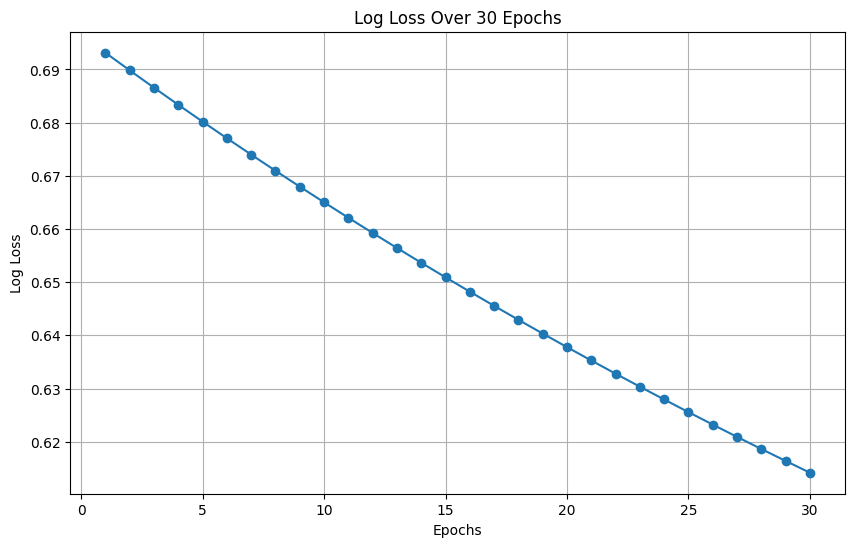

In [10]:
#### Gradient Descent [9]#####
    
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, accuracy_score, classification_report
import matplotlib.pyplot as plt

data = pd.read_csv('logn_data.csv')

# Split the data into features (X) and the target variable (y)
X = data.drop(columns=['target'])
y = data['target']

# Split the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define a logistic regression model with custom gradient descent
class LogisticRegressionWithGradientDescent:
    def __init__(self, learning_rate=0.01, max_epochs=30):
        self.learning_rate = learning_rate
        self.max_epochs = max_epochs

    def fit(self, X, y):
        self.theta = np.zeros(X.shape[1])
        self.losses = []

        for epoch in range(self.max_epochs):
            y_pred = self.sigmoid(X.dot(self.theta))
            gradient = X.T.dot(y_pred - y) / len(y)
            self.theta -= self.learning_rate * gradient
            loss = log_loss(y, y_pred)
            self.losses.append(loss)

    def sigmoid(self, z):
        return 1 / (1 + np.exp(-z))

    def predict_proba(self, X):
        return self.sigmoid(X.dot(self.theta))

# Create a logistic regression model with gradient descent
logreg = LogisticRegressionWithGradientDescent(learning_rate=0.1)

# Training loop
logreg.fit(X_train.values, y_train.values)

# Compute training, validation, and test loss
train_prob = logreg.predict_proba(X_train.values)
train_loss = log_loss(y_train, train_prob)

val_prob = logreg.predict_proba(X_val.values)
val_loss = log_loss(y_val, val_prob)

test_prob = logreg.predict_proba(X_test.values)
test_loss = log_loss(y_test, test_prob)

# Calculate accuracy
train_accuracy = accuracy_score(y_train, (train_prob >= 0.5).astype(int))
val_accuracy = accuracy_score(y_val, (val_prob >= 0.5).astype(int))
test_accuracy = accuracy_score(y_test, (test_prob >= 0.5).astype(int))

# Display training, validation, and test loss and accuracy over 30 epochs
print(f"Training Loss: {train_loss:.5f}, Accuracy: {train_accuracy:.5f}")
print(f"Validation Loss: {val_loss:.5f}, Accuracy: {val_accuracy:.5f}")
print(f"Test Loss: {test_loss:.5f}, Accuracy: {test_accuracy:.5f}")

# Classification report
test_predictions = (test_prob >= 0.5).astype(int)
gradient_descent_report = classification_report(y_test, test_predictions)

print("Classification Report:\n", gradient_descent_report)

# Plot the loss over epochs
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(logreg.losses) + 1), logreg.losses, marker='o')
plt.xlabel('Epochs')
plt.ylabel('Log Loss')
plt.title('Log Loss Over 30 Epochs')
plt.grid()
plt.show()

#### i) Subtask 3.b

Training Loss: 0.61198, Accuracy: 0.80141
Validation Loss: 0.61024, Accuracy: 0.82237
Test Loss: 0.63633, Accuracy: 0.71895
Classification Report:
               precision    recall  f1-score   support

         0.0       0.76      0.63      0.69        75
         1.0       0.69      0.81      0.75        78

    accuracy                           0.72       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.72      0.72      0.72       153



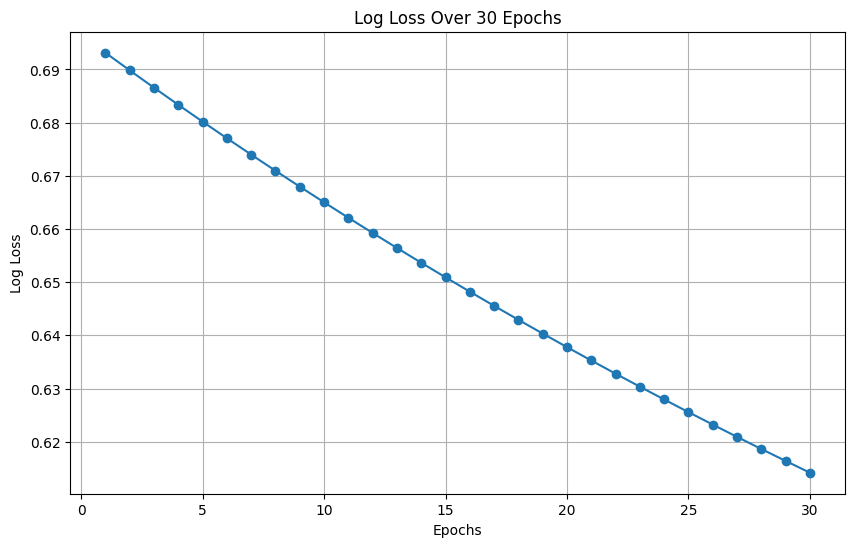

In [11]:
#### Batch Gradient Descent [10]####

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, accuracy_score
import matplotlib.pyplot as plt

data = pd.read_csv('logn_data.csv')

# Split the data into features (X) and the target variable (y)
X = data.drop(columns=['target'])
y = data['target']

# Split the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define a logistic regression model with batch gradient descent
class LogisticRegressionWithBatchGradientDescent:
    def __init__(self, learning_rate=0.01, max_epochs=30):
        self.learning_rate = learning_rate
        self.max_epochs = max_epochs

    def fit(self, X, y):
        self.theta = np.zeros(X.shape[1])
        self.losses = []

        for epoch in range(self.max_epochs):
            y_pred = self.sigmoid(X.dot(self.theta))
            gradient = X.T.dot(y_pred - y) / len(y)
            self.theta -= self.learning_rate * gradient
            loss = log_loss(y, y_pred)
            self.losses.append(loss)

    def sigmoid(self, z):
        return 1 / (1 + np.exp(-z))

    def predict_proba(self, X):
        return self.sigmoid(X.dot(self.theta))

# Create a logistic regression model with batch gradient descent
logreg = LogisticRegressionWithBatchGradientDescent(learning_rate=0.1)

# Training loop
logreg.fit(X_train.values, y_train.values)

# Compute training, validation, and test loss
train_prob = logreg.predict_proba(X_train.values)
train_loss = log_loss(y_train, train_prob)

val_prob = logreg.predict_proba(X_val.values)
val_loss = log_loss(y_val, val_prob)

test_prob = logreg.predict_proba(X_test.values)
test_loss = log_loss(y_test, test_prob)

# Calculate accuracy
train_accuracy = accuracy_score(y_train, (train_prob >= 0.5).astype(int))
val_accuracy = accuracy_score(y_val, (val_prob >= 0.5).astype(int))
test_accuracy = accuracy_score(y_test, (test_prob >= 0.5).astype(int))

# Display training, validation, and test loss and accuracy over 30 epochs
print(f"Training Loss: {train_loss:.5f}, Accuracy: {train_accuracy:.5f}")
print(f"Validation Loss: {val_loss:.5f}, Accuracy: {val_accuracy:.5f}")
print(f"Test Loss: {test_loss:.5f}, Accuracy: {test_accuracy:.5f}")

# Classification report
test_predictions = (test_prob >= 0.5).astype(int)
batch_gradient_descent_report = classification_report(y_test, test_predictions)

print("Classification Report:\n", batch_gradient_descent_report)

# Plot the loss over epochs
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(logreg.losses) + 1), logreg.losses, marker='o')
plt.xlabel('Epochs')
plt.ylabel('Log Loss')
plt.title('Log Loss Over 30 Epochs')
plt.grid()
plt.show()


Training Loss: 0.38670, Accuracy: 0.82535
Validation Loss: 0.38486, Accuracy: 0.87500
Test Loss: 0.46134, Accuracy: 0.74510
Classification Report:
               precision    recall  f1-score   support

         0.0       0.77      0.68      0.72        75
         1.0       0.72      0.81      0.76        78

    accuracy                           0.75       153
   macro avg       0.75      0.74      0.74       153
weighted avg       0.75      0.75      0.74       153



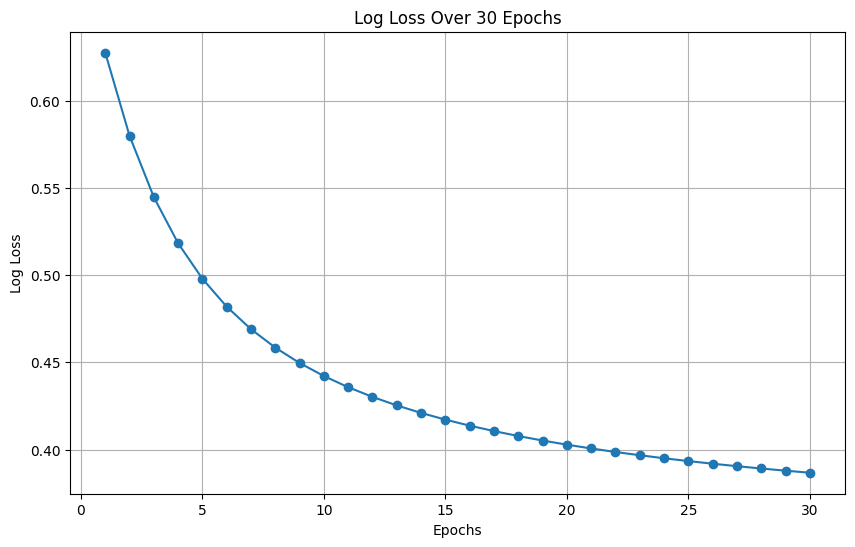

In [12]:
#### Mini-Batch Gradient Descent [11]####

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, accuracy_score
import matplotlib.pyplot as plt

data = pd.read_csv('logn_data.csv')

# Split the data into features (X) and the target variable (y)
X = data.drop(columns=['target'])
y = data['target']

# Split the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define a logistic regression model with mini-batch gradient descent
class LogisticRegressionWithMiniBatchGradientDescent:
    def __init__(self, learning_rate=0.01, max_epochs=30, batch_size=32):
        self.learning_rate = learning_rate
        self.max_epochs = max_epochs
        self.batch_size = batch_size

    def fit(self, X, y):
        self.theta = np.zeros(X.shape[1])
        self.losses = []

        for epoch in range(self.max_epochs):
            for batch_start in range(0, len(X), self.batch_size):
                X_batch = X[batch_start:batch_start + self.batch_size]
                y_batch = y[batch_start:batch_start + self.batch_size]

                y_pred = self.sigmoid(X_batch.dot(self.theta))
                gradient = X_batch.T.dot(y_pred - y_batch) / len(y_batch)
                self.theta -= self.learning_rate * gradient

            y_pred = self.sigmoid(X.dot(self.theta))
            loss = log_loss(y, y_pred)
            self.losses.append(loss)

    def sigmoid(self, z):
        return 1 / (1 + np.exp(-z))

    def predict_proba(self, X):
        return self.sigmoid(X.dot(self.theta))

# Create a logistic regression model with mini-batch gradient descent
logreg = LogisticRegressionWithMiniBatchGradientDescent(learning_rate=0.1, batch_size=32)

# Training loop
logreg.fit(X_train.values, y_train.values)

# Compute training, validation, and test loss
train_prob = logreg.predict_proba(X_train.values)
train_loss = log_loss(y_train, train_prob)

val_prob = logreg.predict_proba(X_val.values)
val_loss = log_loss(y_val, val_prob)

test_prob = logreg.predict_proba(X_test.values)
test_loss = log_loss(y_test, test_prob)

# Calculate accuracy
train_accuracy = accuracy_score(y_train, (train_prob >= 0.5).astype(int))
val_accuracy = accuracy_score(y_val, (val_prob >= 0.5).astype(int))
test_accuracy = accuracy_score(y_test, (test_prob >= 0.5).astype(int))

# Display training, validation, and test loss and accuracy over 30 epochs
print(f"Training Loss: {train_loss:.5f}, Accuracy: {train_accuracy:.5f}")
print(f"Validation Loss: {val_loss:.5f}, Accuracy: {val_accuracy:.5f}")
print(f"Test Loss: {test_loss:.5f}, Accuracy: {test_accuracy:.5f}")

# Classification report
test_predictions = (test_prob >= 0.5).astype(int)
mini_batch_report = classification_report(y_test, test_predictions)

print("Classification Report:\n", mini_batch_report)

# Plot the loss over epochs
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(logreg.losses) + 1), logreg.losses, marker='o')
plt.xlabel('Epochs')
plt.ylabel('Log Loss')
plt.title('Log Loss Over 30 Epochs')
plt.grid()
plt.show()


Training Loss: 0.36946, Accuracy: 0.82676
Validation Loss: 0.36920, Accuracy: 0.84211
Test Loss: 0.44733, Accuracy: 0.77124
Classification Report:
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78        75
         1.0       0.82      0.71      0.76        78

    accuracy                           0.77       153
   macro avg       0.78      0.77      0.77       153
weighted avg       0.78      0.77      0.77       153



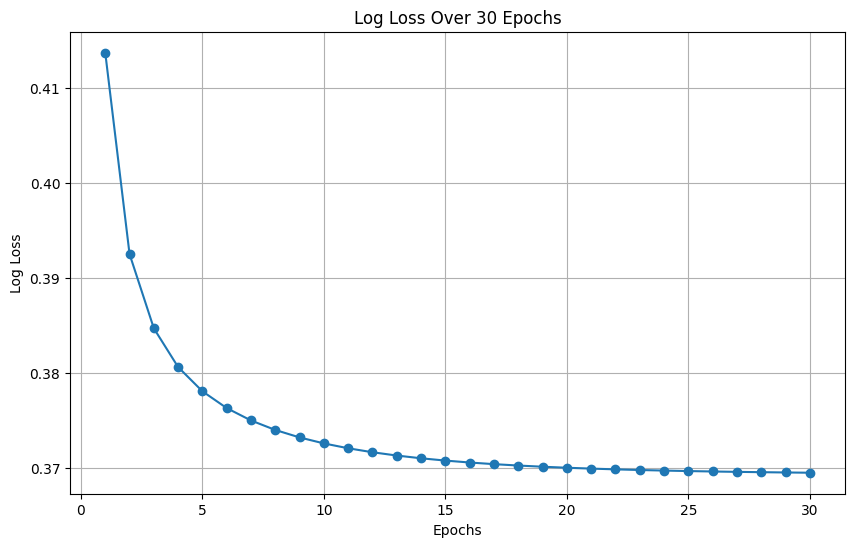

In [13]:
#### Stochastic Gradient Descent [12]####

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, accuracy_score
import matplotlib.pyplot as plt

data = pd.read_csv('logn_data.csv')

# Split the data into features (X) and the target variable (y)
X = data.drop(columns=['target'])
y = data['target']

# Split the data into training, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define a logistic regression model with stochastic gradient descent
class LogisticRegressionWithStochasticGradientDescent:
    def __init__(self, learning_rate=0.01, max_epochs=30):
        self.learning_rate = learning_rate
        self.max_epochs = max_epochs

    def fit(self, X, y):
        self.theta = np.zeros(X.shape[1])
        self.losses = []

        for epoch in range(self.max_epochs):
            for i in range(len(X)):
                X_stochastic = X.iloc[i:i + 1]
                y_stochastic = y.iloc[i:i + 1]

                y_pred = self.sigmoid(X_stochastic.dot(self.theta))
                gradient = X_stochastic.T.dot(y_pred - y_stochastic)
                self.theta -= self.learning_rate * gradient

            y_pred = self.sigmoid(X.dot(self.theta))
            loss = log_loss(y, y_pred)
            self.losses.append(loss)

    def sigmoid(self, z):
        return 1 / (1 + np.exp(-z))

    def predict_proba(self, X):
        return self.sigmoid(X.dot(self.theta))

# Create a logistic regression model with stochastic gradient descent
logreg = LogisticRegressionWithStochasticGradientDescent(learning_rate=0.1)

# Training loop
logreg.fit(X_train, y_train)

# Compute training, validation, and test loss
train_prob = logreg.predict_proba(X_train)
train_loss = log_loss(y_train, train_prob)

val_prob = logreg.predict_proba(X_val)
val_loss = log_loss(y_val, val_prob)

test_prob = logreg.predict_proba(X_test)
test_loss = log_loss(y_test, test_prob)

# Calculate accuracy
train_accuracy = accuracy_score(y_train, (train_prob >= 0.5).astype(int))
val_accuracy = accuracy_score(y_val, (val_prob >= 0.5).astype(int))
test_accuracy = accuracy_score(y_test, (test_prob >= 0.5).astype(int))

# Display training, validation, and test loss and accuracy over 30 epochs
print(f"Training Loss: {train_loss:.5f}, Accuracy: {train_accuracy:.5f}")
print(f"Validation Loss: {val_loss:.5f}, Accuracy: {val_accuracy:.5f}")
print(f"Test Loss: {test_loss:.5f}, Accuracy: {test_accuracy:.5f}")

# Classification report
test_predictions = (test_prob >= 0.5).astype(int)
stochastic_report = classification_report(y_test, test_predictions)

print("Classification Report:\n", stochastic_report)

# Plot the loss over epochs
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(logreg.losses) + 1), logreg.losses, marker='o')
plt.xlabel('Epochs')
plt.ylabel('Log Loss')
plt.title('Log Loss Over 30 Epochs')
plt.grid()
plt.show()


### 4. Task 4

#### i) Subtask 4.a

The evaluation metric I used was the classification report due to its comprehensive and informative assessment of its performance. Unlike a single metric like accuracy, which provides a high-level overview of correct predictions, the classification report delves deeper into the model's capabilities by considering metrics such as precision, recall, and F1-score. These metrics provide a nuanced understanding of the model's ability to correctly classify both positive and negative instances, helping me evaluate its overall effectiveness. Therefore, the classification report serves as a robust evaluation tool, offering a more complete picture of the model's performance and guiding in making informed decisions about its suitability for the specific classification task at hand.

In [14]:
print('Naive Bayes Report:')
print(naive_report)

print('Gradient Descent:')
print(gradient_descent_report)

print('Batch Gradient Descent Report:')
print(batch_gradient_descent_report)

print('Mini Batch Gradient Descent:')
print(mini_batch_report)

print('Stochastic Gradient Descent:')
print(stochastic_report)

Naive Bayes Report:
              precision    recall  f1-score   support

         0.0       0.83      0.74      0.78        97
         1.0       0.78      0.86      0.82       106

    accuracy                           0.80       203
   macro avg       0.81      0.80      0.80       203
weighted avg       0.81      0.80      0.80       203

Gradient Descent:
              precision    recall  f1-score   support

         0.0       0.76      0.63      0.69        75
         1.0       0.69      0.81      0.75        78

    accuracy                           0.72       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.72      0.72      0.72       153

Batch Gradient Descent Report:
              precision    recall  f1-score   support

         0.0       0.76      0.63      0.69        75
         1.0       0.69      0.81      0.75        78

    accuracy                           0.72       153
   macro avg       0.73      0.72      0.72       153
weigh

#### i) Subtask 4.b

The scores for Naive Bayes and Stochastic Gradient Descent (SGD) appear to be better than the other models in the classification task based on the classification reports for several reasons:

Naive Bayes:

Simplicity and Independence Assumption: Naive Bayes is a simple and computationally efficient algorithm that assumes independence between features.

Well-suited for Text and Categorical Data: Naive Bayes is commonly used for text classification and categorical data, where its assumptions may hold to a greater extent. 

Balanced Precision and Recall: The classification report shows balanced precision and recall for both classes (0 and 1). This indicates that Naive Bayes is making accurate predictions for both positive and negative instances, leading to a balanced F1-score.

Stochastic Gradient Descent (SGD):

Iterative Optimization: SGD is an iterative optimization algorithm that updates the model parameters using a small random subset of the training data in each iteration. This makes it flexible and adaptable to a wide range of datasets.

Faster Convergence: SGD's frequent updates and random sampling can lead to faster convergence, especially in large datasets. It allows the model to adjust quickly to the data.

Flexibility in Hyperparameter Tuning: SGD provides flexibility in hyperparameter tuning, allowing you to fine-tune learning rates, batch sizes, and other parameters for optimal performance.

Improved Recall: The classification report for SGD shows a higher recall for class 1. This means that SGD is better at capturing positive instances, which is particularly important in scenarios where correctly identifying positive cases is a priority.

However, the best model would be the stochastic gradient descent model as it offers the lowest training loss as the model optimizes for it during training. Validation loss is close to the training loss but slightly higher, and test loss is low and close to the validation loss. If validation or test loss is significantly higher than training loss, it suggests potential issues like overfitting. The goal to achieve good generalization to new data while minimizing overfitting is hence achieved here [13].

### 5. Task 5

#### i) Subtask 5.a

Probability of all components of Bayesian Approach

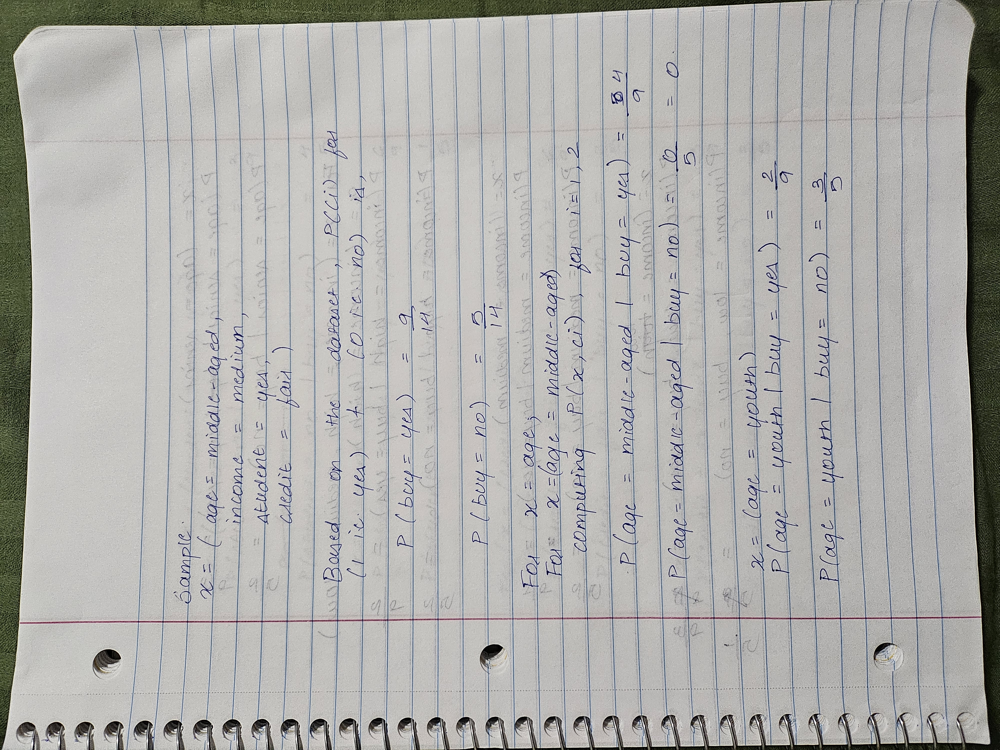

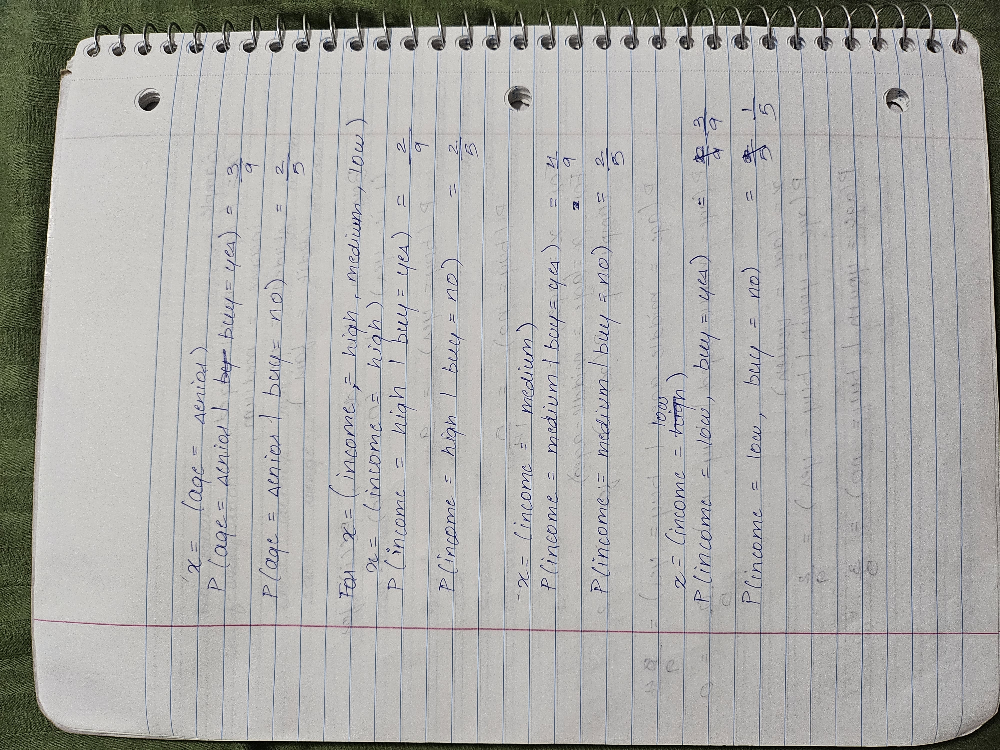

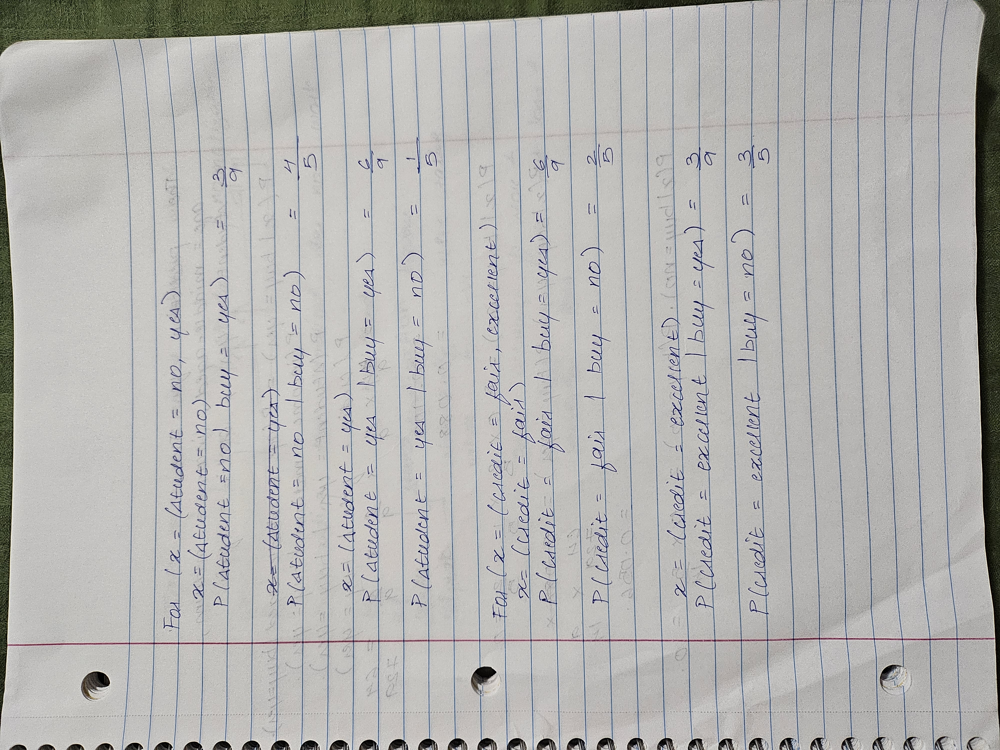

#### ii) Subtask 5.b

Naive Bayes Classifier for Jack

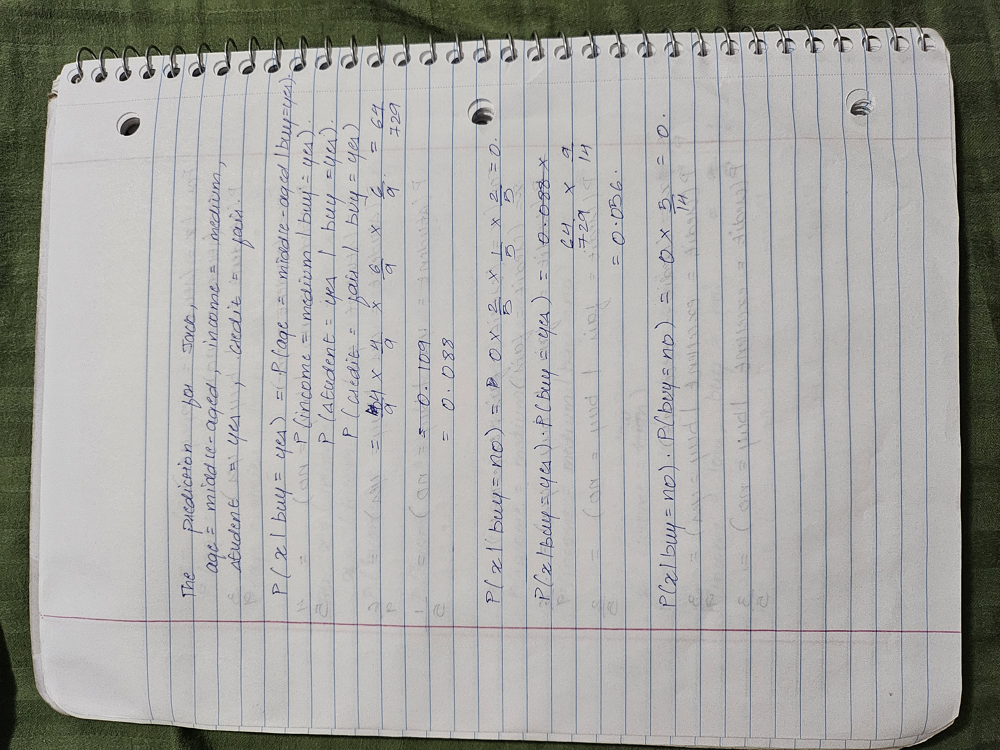

### References:

1. Heart disease dataset. (2019, June 6). Kaggle. https://www.kaggle.com/datasets/johnsmith88/heart-disease-dataset
2. Mallidi, A. R. (2022, February 7). A Comprehensive guide on handling Missing Values - #ByCodeGarage - Medium. Medium. https://medium.com/bycodegarage/a-comprehensive-guide-on-handling-missing-values-b1257a4866d1
3. Ewuzie, U., Bolade, O. P., & Egbedina, A. O. (2022). Application of deep learning and machine learning methods in water quality modeling and prediction: a review. In Elsevier eBooks (pp. 185–218). https://doi.org/10.1016/b978-0-323-85597-6.00020-3
4. Plummer, A. (2022, September 16). Box-Cox transformation and target variable: explained. Built In. https://builtin.com/data-science/box-cox-transformation-target-variable
5. What if outliers still exist after variable transformation? (n.d.). Data Science Stack Exchange. https://datascience.stackexchange.com/questions/94958/what-if-outliers-still-exist-after-variable-transformation
6. Suresh, A. (2021, December 22). How to remove outliers for machine Learning? - Analytics Vidhya - medium. Medium. https://medium.com/analytics-vidhya/how-to-remove-outliers-for-machine-learning-24620c4657e8
7. Brownlee, J. (2020, August 27). How to use StandardScaler and MinMaxScaler Transforms in Python. MachineLearningMastery.com. https://machinelearningmastery.com/standardscaler-and-minmaxscaler-transforms-in-python/
8. 1.9. Naive Bayes. (n.d.). Scikit-learn. https://scikit-learn.org/stable/modules/naive_bayes.html
9. sklearn.linear_model.LogisticRegression. (n.d.). Scikit-learn. https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
10. Zhao, J. Y. (2023, July 26). Python implementation of batch gradient descent - Joey Yi Zhao - Medium. Medium. https://medium.com/@zhaoyi0113/python-implementation-of-batch-gradient-descent-379fa19eb428
11. GeeksforGeeks. (2022, August 2). ML   Mini Batch Gradient Descent with Python. https://www.geeksforgeeks.org/ml-mini-batch-gradient-descent-with-python/
12. GeeksforGeeks. (2023, May 29). ML Stochastic Gradient Descent SGD. https://www.geeksforgeeks.org/ml-stochastic-gradient-descent-sgd/?ref=lbp
13. When training a deep learning model should the validation loss be greater than or smaller than the training loss? | ResearchGate. (n.d.-b). ResearchGate. https://www.researchgate.net/post/When_training_a_deep_learning_model_should_the_validation_loss_be_greater_than_or_smaller_than_the_training_loss#:~:text=Typically%20the%20validation%20loss%20is,method%20to%20prevent%20the%20overfitting.&text=The%20results%20of%20the%20network,always%20better%20than%20during%20verification.